# Importning Necessary Libraries and mounting drive

1. Import Necessary Libraries:

In [ ]:
import tensorflow as tf
# from tensorflow.keras.layers import Conv2D, MaxPooling2D, TimeDistributed, Flatten, LSTM, Dense, Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras.losses import mean_squared_error, binary_crossentropy
from google.colab import drive
import cv2
import os
import numpy as np
from sklearn.model_selection import train_test_split

2. Mount Google Drive:

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


3. Define Data Paths:

In [ ]:
data_dir = '/content/drive/MyDrive/FYP - Munz/Dataset'
normal_videos_dir = os.path.join(data_dir, 'Normal')
shoplifting_videos_dir = os.path.join(data_dir, 'Shoplifting')

# Preprocessing

4. Load and Preprocess Videos:

In [ ]:
# Function to get paths for labeled and unlabeled videos
def get_video_paths(directory, labeled=True):
    video_paths_labels = []
    video_counter = 0
    for root, _, files in os.walk(directory):
          for file in files:
              if file.endswith(".mp4"):
                video_counter +=1
                if (labeled == True and video_counter <= len(files)//2 ) or (labeled == False and video_counter > len(files)//2 ) :
                  video_path = os.path.join(root, file)
                  label = 1 if "Shoplifting" in os.path.basename(root) else 0 if labeled else -1
                  video_paths_labels.append((video_path, label))
    return video_paths_labels

In [ ]:
# Get video paths
normal_videos = get_video_paths(normal_videos_dir)
shoplifting_videos = get_video_paths(shoplifting_videos_dir)
unlabeled_1 = get_video_paths(normal_videos_dir, labeled=False)
unlabeled_2 = get_video_paths(shoplifting_videos_dir, labeled=False)

In [ ]:
# Split normal videos
normal_train, normal_test = train_test_split(normal_videos, test_size=0.2, random_state=42)
normal_train, normal_val = train_test_split(normal_train, test_size=0.25, random_state=42)

# Split shoplifting videos
shoplifting_train, shoplifting_test = train_test_split(shoplifting_videos, test_size=0.2, random_state=42)
shoplifting_train, shoplifting_val = train_test_split(shoplifting_train, test_size=0.25, random_state=42)

In [ ]:
import cv2
import numpy as np

def load_and_preprocess_videos(video_paths_labels):
    """Loads videos, extracts and preprocesses frames, and combines them into sequences.

    Args:
        video_paths_labels (list): List of tuples containing paths to video files and corresponding labels.

    Returns:
        tuple: (video_sequences, labels)
            video_sequences (np.ndarray): 4D array of shape (num_videos, seq_length, height, width, channels)
            labels (np.ndarray): 1D array of labels for each video
    """

    video_sequences = []
    video_labels = []
    excluded = 0
    video_count = 0

    for video_path, label in video_paths_labels:
        video_count = video_count + 1
        cap = cv2.VideoCapture(video_path)

        # Determine the video's FPS
        fps = cap.get(cv2.CAP_PROP_FPS)
        frame_skip = int(fps)  # Number of frames to skip to achieve roughly 1 frame per second

        frames = []
        flipped_frames = []
        frame_count = 0

        while True:
            ret, frame = cap.read()

            if not ret:
                break

            # Skip frames to reduce to approximately 1 FPS
            if frame_count % frame_skip != 0:
                frame_count += 1
                continue

            # Preprocess frame: resize and convert to grayscale
            frame = cv2.resize(frame, (128, 128))
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            frames.append(frame)
            flipped_frames.append(cv2.flip(frame, 1))

            frame_count += 1

        cap.release()

        seq_length = 10
        # After the video is processed, check the number of frames:
        if len(frames) < seq_length :  # Assuming you aim for 100 frames
            pad_amount = seq_length - len(frames)
            frames = np.pad(frames, ((0, pad_amount), (0, 0), (0, 0)), mode='constant')

        # Extract sequences of length 10 from frames
        for i in range(0, len(frames), seq_length):
            sequence = frames[i:i + seq_length]
            if len(sequence) == seq_length:
                sequence = np.array(sequence).astype('float32') / 255.0
                sequence = np.expand_dims(sequence, axis=-1)  # Add channel dimension
                video_sequences.append(sequence)
                video_labels.append(label)
            else:
              excluded = excluded + 1

        # Extract sequences of length 10 from frames
        if video_count % 2 == 0 :
          for i in range(0, len(flipped_frames), seq_length):
              sequence = flipped_frames[i:i + seq_length]
              if len(sequence) == seq_length:
                  sequence = np.array(sequence).astype('float32') / 255.0
                  sequence = np.expand_dims(sequence, axis=-1)  # Add channel dimension
                  video_sequences.append(sequence)
                  video_labels.append(label)
              else:
                excluded = excluded + 1

    print("Seq length = ", len(video_sequences), "   " , "Excluded = ", excluded)
    return np.array(video_sequences), np.array(video_labels)


In [ ]:
# Combine and load data
X_train_labeled, y_train_labeled = load_and_preprocess_videos(normal_train + shoplifting_train)

Seq length =  310     Excluded =  76


In [ ]:
X_val, y_val = load_and_preprocess_videos(normal_val + shoplifting_val)

Seq length =  93     Excluded =  21


In [ ]:
X_test_labeled, y_test_labeled = load_and_preprocess_videos(normal_test + shoplifting_test)

Seq length =  104     Excluded =  25


In [ ]:
unlabeled_videos1, _ = load_and_preprocess_videos(unlabeled_1)

Seq length =  426     Excluded =  71


In [ ]:
unlabeled_videos2, __ = load_and_preprocess_videos(unlabeled_2)

Seq length =  321     Excluded =  61


In [ ]:
save_path = '/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/' # Replace with your desired path

In [ ]:
np.save(save_path + 'X_train_labeled_x_5.npy', X_train_labeled)
np.save(save_path + 'y_train_labeled_x_5.npy', y_train_labeled)

In [ ]:
X_train_labeled = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/X_train_labeled_x_5.npy')
y_train_labeled = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/y_train_labeled_x_5.npy')

In [ ]:
np.save(save_path + 'X_val_x_5.npy', X_val)
np.save(save_path + 'y_val_x_5.npy', y_val)

In [ ]:
X_val = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/X_val_x_5.npy')
y_val = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/y_val_x_5.npy')

In [ ]:
np.save(save_path + 'X_test_labeled_x_5.npy', X_test_labeled)
np.save(save_path + 'y_test_labeled_x_5.npy', y_test_labeled)

In [ ]:
X_test_labeled = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/X_test_labeled_x_5.npy')
y_test_labeled = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/y_test_labeled_x_5.npy')

In [ ]:
np.save(save_path + 'unlabeled_videos1_x_5.npy', unlabeled_videos1 )
np.save(save_path + 'a_x_5.npy', _ )

In [ ]:
unlabeled_videos1 = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/unlabeled_videos1_x_5.npy')
_ = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/a_x_5.npy')

In [ ]:
np.save(save_path + 'unlabeled_videos2_x_5.npy', unlabeled_videos2 )
np.save(save_path + 'aa_x_5.npy', __ )

In [ ]:
unlabeled_videos2 = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/unlabeled_videos2_x_5.npy')
__ = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/aa_x_5.npy')

## 5. Combine and Split Data:

In [ ]:
X_unlabeled = ''
X_train_combined = ''
y_train_combined = ''

In [ ]:
X_unlabeled = np.concatenate((unlabeled_videos1, unlabeled_videos2))

In [ ]:

np.save(save_path + 'X_unlabeled_5.npy', X_unlabeled)

In [ ]:
X_unlabeled = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/X_unlabeled_5.npy')

In [ ]:
# Combine labeled and unlabeled data
X_train_combined = np.concatenate((X_train_labeled, X_unlabeled))
y_train_combined = np.concatenate((y_train_labeled, -1 * np.ones(len(X_unlabeled))))  # Use -1 for unlabeled samples

In [ ]:
np.save(save_path + 'X_train_combined_5.npy', X_train_combined)
np.save(save_path + 'y_train_combined_5.npy', y_train_combined)

In [ ]:
X_train_combined = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/X_train_combined_5.npy')
y_train_combined = np.load('/content/drive/MyDrive/FYP - Munz/Dataset/Video_Sequences/y_train_combined_5.npy')

In [ ]:
print(len(normal_train), len(normal_val), len(normal_test), '\n' )
print(len(shoplifting_train), len(shoplifting_val), len(shoplifting_test), '\n')
print(len(X_train_labeled), len(y_train_labeled), len(unlabeled_videos1) , len(unlabeled_videos2), '\n')

### Print splits path -  not important

## Save and Load Explicit split data

### Load Explicit Data

In [ ]:
def load_video_paths(directory, labeled=True, Catergory = ''):
    video_paths_labels = []
    video_counter = 0
    for root, _, files in os.walk(directory):
          for file in files:
              if file.endswith(".mp4"):
                  video_path = os.path.join(root, file)
                  if labeled:
                      if Catergory == "Shoplifting":
                        label = 1
                      else:
                        label = 0
                  else:
                      label = -1
                  video_paths_labels.append((video_path, label))
    return video_paths_labels

In [ ]:
normal_train = load_video_paths('/content/drive/MyDrive/FYP - Munz/Dataset/Test123/normal_train',True, 'Normal')

In [ ]:
normal_val = load_video_paths('/content/drive/MyDrive/FYP - Munz/Dataset/Test123/normal_val',True, 'Normal')

In [ ]:
normal_test = load_video_paths('/content/drive/MyDrive/FYP - Munz/Dataset/Test123/normal_test',True, 'Normal')

In [ ]:
shoplifting_train = load_video_paths('/content/drive/MyDrive/FYP - Munz/Dataset/Test123/shoplifting_train',True, 'Shoplifting')

In [ ]:
shoplifting_val =  load_video_paths('/content/drive/MyDrive/FYP - Munz/Dataset/Test123/shoplifting_val',True, 'Shoplifting')

In [ ]:
shoplifting_test = load_video_paths('/content/drive/MyDrive/FYP - Munz/Dataset/Test123/shoplifting_test',True, 'Shoplifting')

In [ ]:
unlabeled_1 = load_video_paths('/content/drive/MyDrive/FYP - Munz/Dataset/Test123/unlabeled_1', False)

In [ ]:
unlabeled_2 = load_video_paths('/content/drive/MyDrive/FYP - Munz/Dataset/Test123/unlabeled_2', False)

### Save Explicit split data in seperate folders

In [ ]:
import shutil
def copy_path(set_name, destination_dir):
  for i, (video_path, label) in enumerate(set_name):
    print(video_path, ',')

    # Create destination filename (add label and index for clarity)
    file_name = os.path.basename(video_path)
    dest_file = os.path.join(destination_dir, f'{label}_{i}_{file_name}')

    # Create destination directory if needed
    os.makedirs(destination_dir, exist_ok=True)

    # Copy the file
    shutil.copyfile(video_path, dest_file)

In [ ]:
copy_path(normal_train, '/content/drive/MyDrive/FYP - Munz/Dataset/Test123/normal_train_f')

In [ ]:
copy_path(normal_val, '/content/drive/MyDrive/FYP - Munz/Dataset/Test123/normal_val_f')

In [ ]:
copy_path(normal_test, '/content/drive/MyDrive/FYP - Munz/Dataset/Test123/normal_test_f')

In [ ]:
copy_path(shoplifting_train, '/content/drive/MyDrive/FYP - Munz/Dataset/Test123/shoplifting_train_f')

In [ ]:
copy_path(shoplifting_val, '/content/drive/MyDrive/FYP - Munz/Dataset/Test123/shoplifting_val_f')

In [ ]:
copy_path(shoplifting_test, '/content/drive/MyDrive/FYP - Munz/Dataset/Test123/shoplifting_test_f')

In [ ]:
copy_path(unlabeled_1, '/content/drive/MyDrive/FYP - Munz/Dataset/Test123/unlabeled_1_f')

In [ ]:
copy_path(unlabeled_2, '/content/drive/MyDrive/FYP - Munz/Dataset/Test123/unlabeled_2_f')

# Model Building

6. Design LSTM Architecture:

In [ ]:
from tensorflow.keras.layers import Conv2D, TimeDistributed, MaxPooling2D, Flatten, LSTM, Dropout, Dense

model = Sequential([
    TimeDistributed(Conv2D(32, (3, 3), activation='relu'), input_shape=(10, 128, 128, 1)),  # Adjust frame shape
    TimeDistributed(MaxPooling2D((2, 2))),
    TimeDistributed(Conv2D(64, (3, 3), activation='relu')),
    TimeDistributed(MaxPooling2D((2, 2))),
    TimeDistributed(Flatten()),
    LSTM(64, return_sequences=True),
    Dropout(0.2),
    LSTM(32),
    Dense(1, activation='sigmoid', kernel_regularizer=tf.keras.regularizers.l2(0.01))  # Main shoplifter detection output
])

7. Compile the Model:

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0005)
model.compile(loss=binary_crossentropy, optimizer='adam', metrics=['accuracy'])

# Train

8. Train the Model:

## Semi Supervised

In [ ]:
from tensorflow.keras.callbacks import LearningRateScheduler

In [ ]:
# Define your learning rate schedule
def lr_schedule(epoch, lr):
    # Reduce the learning rate after certain epochs
    if epoch > 0 and epoch % 10 == 0:
        lr = lr * 0.1
    return lr

# Learning Rate Scheduler Callback
lr_scheduler_callback = LearningRateScheduler(lr_schedule)

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

def train_ssl_model(model, X_train_labeled, y_train_labeled, X_unlabeled, X_val, y_val, epochs=15, batch_size=32):
    # Initially train on the labeled data only
    print("Training on labeled data")
    model.fit(X_train_labeled, y_train_labeled, epochs=epochs, batch_size=batch_size,
              validation_data=(X_val, y_val), callbacks=[lr_scheduler_callback])

    # SSL Loop: Generate pseudo-labels and train on the combined dataset
    for epoch in range(epochs):
        print(f"SSL Training Epoch: {epoch+1}/{epochs}")

        # Predict on unlabeled data to generate pseudo-labels
        unlabeled_predictions = model.predict(X_unlabeled)
        pseudo_labels = np.where(unlabeled_predictions > 0.8, 1, 0)  # Threshold can be adjusted

        y_train_combined = np.concatenate((y_train_labeled, pseudo_labels.flatten()))

        # Train on the combined dataset
        model.fit(X_train_combined, y_train_combined, batch_size=batch_size, epochs=1,
                  validation_data=(X_val, y_val), callbacks=[lr_scheduler_callback])

    return model

# Assuming 'model' is your Keras model instance and data is prepared
model = train_ssl_model(model, X_train_labeled, y_train_labeled, X_unlabeled, X_val, y_val,
                        epochs=10, batch_size=32)


Training on labeled data
Epoch 1/10
10/10 [==============================] - 6s 270ms/step - loss: 0.7253 - accuracy: 0.5065 - val_loss: 0.6692 - val_accuracy: 0.8387 - lr: 0.0010
Epoch 2/10
10/10 [==============================] - 2s 168ms/step - loss: 0.6783 - accuracy: 0.6903 - val_loss: 0.6017 - val_accuracy: 0.8495 - lr: 0.0010
Epoch 3/10
10/10 [==============================] - 2s 178ms/step - loss: 0.6209 - accuracy: 0.7161 - val_loss: 0.5491 - val_accuracy: 0.8495 - lr: 0.0010
Epoch 4/10
10/10 [==============================] - 2s 179ms/step - loss: 0.5642 - accuracy: 0.7548 - val_loss: 0.4900 - val_accuracy: 0.8710 - lr: 0.0010
Epoch 5/10
10/10 [==============================] - 2s 173ms/step - loss: 0.4135 - accuracy: 0.8742 - val_loss: 0.5877 - val_accuracy: 0.7312 - lr: 0.0010
Epoch 6/10
10/10 [==============================] - 2s 171ms/step - loss: 0.2201 - accuracy: 0.9516 - val_loss: 0.8980 - val_accuracy: 0.5699 - lr: 0.0010
Epoch 7/10
10/10 [===========================

In [ ]:
model.save('/content/drive/MyDrive/FYP - Munz/Model/ssl_model_x_5_1.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
model = tf.keras.models.load_model('/content/drive/MyDrive/FYP - Munz/Model/ssl_model_x_5.h5')

## Active Learning

In [ ]:
!git clone https://github.com/modAL-python/modAL.git

Cloning into 'modAL'...
remote: Enumerating objects: 4296, done.
remote: Counting objects: 100% (375/375), done.
remote: Compressing objects: 100% (144/144), done.
remote: Total 4296 (delta 235), reused 363 (delta 231), pack-reused 3921
Receiving objects: 100% (4296/4296), 9.36 MiB | 15.82 MiB/s, done.
Resolving deltas: 100% (2676/2676), done.


In [ ]:
%cd modAL

/content/modAL


In [ ]:
!python setup.py install


/usr/local/lib/python3.10/dist-packages/setuptools/dist.py:755: SetuptoolsDeprecationWarning: Invalid dash-separated options
!!

        ********************************************************************************
        Usage of dash-separated 'description-file' will not be supported in future
        versions. Please use the underscore name 'description_file' instead.

        This deprecation is overdue, please update your project and remove deprecated
        calls to avoid build errors in the future.

        See https://setuptools.pypa.io/en/latest/userguide/declarative_config.html for details.
        ********************************************************************************

!!
  opt = self.warn_dash_deprecation(opt, section)
running install
/usr/local/lib/python3.10/dist-packages/setuptools/_distutils/cmd.py:66: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
 

In [ ]:
from scipy.stats import entropy
import modAL
import matplotlib.pyplot as plt
from modAL.models import ActiveLearner

In [ ]:
def select_samples(uncertainty_buffer, current_uncertainty, k=10, method='entropy_plus'):
    # Combine recent uncertainties from buffer
    combined_uncertainty = np.mean(uncertainty_buffer, axis=0) + current_uncertainty

    # Select based on chosen method (replace with your preferred sampling strategy)
    if method == 'entropy_plus':
        uncertainty_sampler = UncertaintySampling(combined_uncertainty)
        top_uncertain_indices = uncertainty_sampler.select_samples(k=k)
    elif method == 'kmeans':
        kmeans_sampler = KMeansSampler(combined_uncertainty)
        top_uncertain_indices = kmeans_sampler.select_samples(k=k)
    elif method == 'least_confidence':
        uncertainty_sampler = UncertaintySampling(combined_uncertainty)
        top_uncertain_indices = uncertainty_sampler.select_samples(k=k)

    return top_uncertain_indices

In [ ]:
# Define uncertainty calculation (replace with your preferred metric)
def calculate_uncertainty(predictions):
    most_confident_class = np.argmax(predictions, axis=1)
    confidence = predictions[np.arange(len(predictions)), most_confident_class]
    uncertainty = 1 - confidence
    return uncertainty

In [ ]:
def get_labels_for_samples(sample_indices, X_unlabeled):
    """
    Simulates labels for the selected samples.

    Args:
        sample_indices: List of indices of selected samples in X_unlabeled.
        X_unlabeled: Array of unlabeled data.

    Returns:
        List of simulated labels for the selected samples.
    """

    simulated_labels = np.random.randint(0, 2, size=len(sample_indices))
    return simulated_labels

10/10 [==============================] - 2s 207ms/step - loss: 0.0259 - accuracy: 1.0000 - val_loss: 1.5162 - val_accuracy: 0.6344
Validation Loss: 1.516215443611145, Validation Accuracy: 0.6344085931777954
10/10 [==============================] - 2s 187ms/step - loss: 0.0257 - accuracy: 1.0000 - val_loss: 1.4419 - val_accuracy: 0.6667
Validation Loss: 1.4418935775756836, Validation Accuracy: 0.6666666865348816
10/10 [==============================] - 2s 193ms/step - loss: 0.0260 - accuracy: 1.0000 - val_loss: 1.3061 - val_accuracy: 0.6989
Validation Loss: 1.306089162826538, Validation Accuracy: 0.698924720287323
10/10 [==============================] - 2s 188ms/step - loss: 0.0275 - accuracy: 1.0000 - val_loss: 1.1797 - val_accuracy: 0.7097
Validation Loss: 1.1796910762786865, Validation Accuracy: 0.7096773982048035
10/10 [==============================] - 2s 183ms/step - loss: 0.0328 - accuracy: 1.0000 - val_loss: 0.9271 - val_accuracy: 0.6989
Validation Loss: 0.9270869493484497, Val

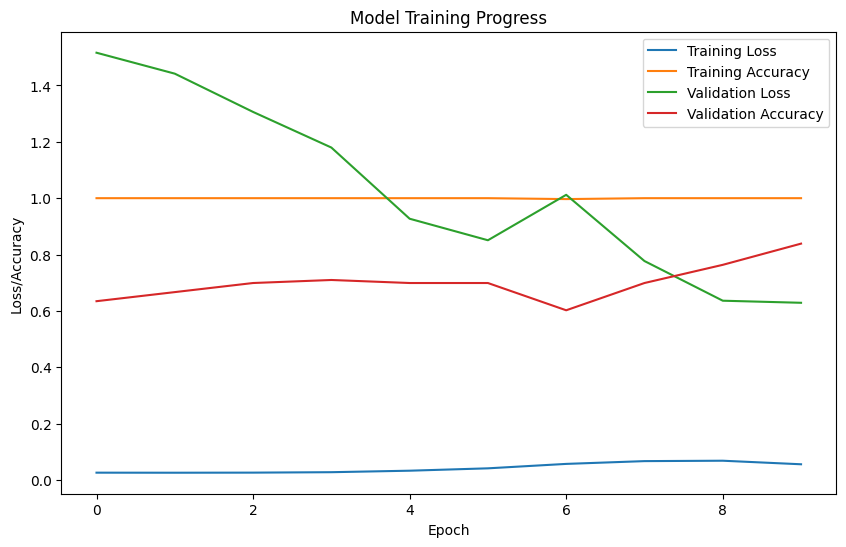

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping


# Select samples using modAL's uncertainty sampling
# Initialize the learner before the loop
learner = modAL.ActiveLearner(
    estimator=model,
    X_training=X_train_labeled, y_training=y_train_labeled
)

# Active learning loop
num_iterations = 10
uncertainty_buffer = []  # Buffer to store recent uncertainties
training_loss = []
training_accuracy = []
validation_loss = []  # If you have validation data
validation_accuracy = []  # If you have validation data

for iteration in range(num_iterations):
    # Train the model on labeled data
    history = model.fit(X_train_labeled, y_train_labeled, epochs=1, batch_size=32,
                  validation_data=(X_val, y_val),
                  callbacks=[EarlyStopping(patience=3)])

    training_loss.append(history.history['loss'][0])
    training_accuracy.append(history.history['accuracy'][0])

    # Evaluate on validation set (if available)
    if X_val is not None and y_val is not None:
        val_metrics = model.evaluate(X_val, y_val, verbose=0)
        print(f"Validation Loss: {val_metrics[0]}, Validation Accuracy: {val_metrics[1]}")
        validation_loss.append(val_metrics[0])
        validation_accuracy.append(val_metrics[1])

    # Predict on unlabeled data
    unlabeled_predictions = model.predict(X_unlabeled)

    # Calculate uncertainty (if needed for other purposes)
    uncertainty = calculate_uncertainty(unlabeled_predictions)

    # Select most uncertain instances (top-k based on uncertainty)
    top_uncertain_indices = np.argsort(uncertainty)[-10:]  # Get indices of 10 most uncertain

    # print(X_unlabeled.shape)   # Add this line

    query_idx = top_uncertain_indices
    query_instance = X_unlabeled[top_uncertain_indices, :, :, :, :]

    # Get labels (Replace with your labeling mechanism)
    acquired_labels = get_labels_for_samples(query_idx, X_unlabeled)

    # Update labeled and unlabeled data (modAL updates internally)
    learner.teach(X=query_instance, y=acquired_labels)

# Evaluate final model performance on the test set
final_test_metrics = model.evaluate(X_test_labeled, y_test_labeled, verbose=0)
print(f"Final Test Loss: {final_test_metrics[0]}, Final Test Accuracy: {final_test_metrics[1]}")

# ... After the active learning loop

plt.figure(figsize=(10, 6))
plt.plot(training_loss, label='Training Loss')
plt.plot(training_accuracy, label='Training Accuracy')

if X_val is not None and y_val is not None:
    plt.plot(validation_loss, label='Validation Loss')
    plt.plot(validation_accuracy, label='Validation Accuracy')

plt.xlabel('Epoch')
plt.ylabel('Loss/Accuracy')
plt.legend()
plt.title('Model Training Progress')
plt.show()

10. Save Model:

In [ ]:
model.save('/content/drive/MyDrive/FYP - Munz/Model/ssal_model_x_5_1.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


11. Load the Trained Model:

In [ ]:
model = tf.keras.models.load_model('/content/drive/MyDrive/FYP - Munz/Model/ssal_model_x_5_1.h5')

# Evaluate

9. Evaluate Performance:

In [ ]:
from sklearn.metrics import confusion_matrix

In [ ]:
y_pred = model.predict(X_test_labeled)
y_pred_binary = np.where(y_pred > 0.5, 1, 0)  # Converting probabilities to binary labels

4/4 [==============================] - 2s 198ms/step


In [ ]:
conf_matrix = confusion_matrix(y_test_labeled, y_pred_binary)

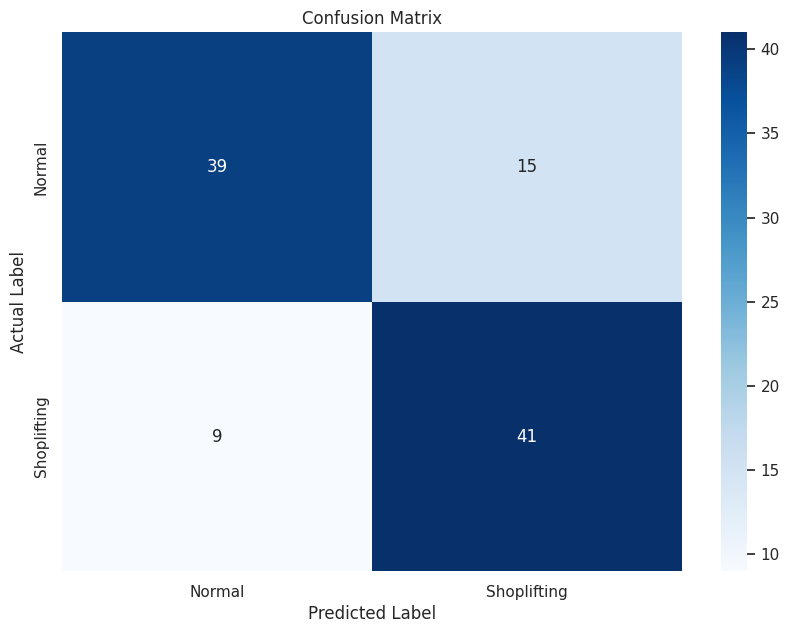

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()  # For a nicer confusion matrix visualization

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=["Normal", "Shoplifting"], yticklabels=["Normal", "Shoplifting"])
plt.ylabel('Actual Label')
plt.xlabel('Predicted Label')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
# SSAL
# Evaluate performance on a separate validation set of labeled videos
model.evaluate(X_val, y_val)

3/3 [==============================] - 0s 49ms/step - loss: 0.6070 - accuracy: 0.8065


[0.6070293188095093, 0.8064516186714172]

In [ ]:
#SSAL
from sklearn.metrics import precision_recall_fscore_support, roc_auc_score

y_pred = model.predict(X_test_labeled)
y_pred_binary = np.where(y_pred > 0.5, 1, 0)

# Calculate precision, recall, f1, and support for each class
precision, recall, f1, support = precision_recall_fscore_support(y_test_labeled, y_pred_binary)

# Print metrics for each class separately
for i in range(len(precision)):
    print(f"Class {i}:")
    print(f"Precision: {precision[i]:.4f}")
    print(f"Recall: {recall[i]:.4f}")
    print(f"F1 score: {f1[i]:.4f}")
    print(f"Support: {support[i]}")

# Calculate AUC-ROC (which is a single value)
auc = roc_auc_score(y_test_labeled, y_pred)
print(f"AUC-ROC: {auc:.4f}")


4/4 [==============================] - 0s 41ms/step
Class 0:
Precision: 0.8125
Recall: 0.7222
F1 score: 0.7647
Support: 54
Class 1:
Precision: 0.7321
Recall: 0.8200
F1 score: 0.7736
Support: 50
AUC-ROC: 0.8237


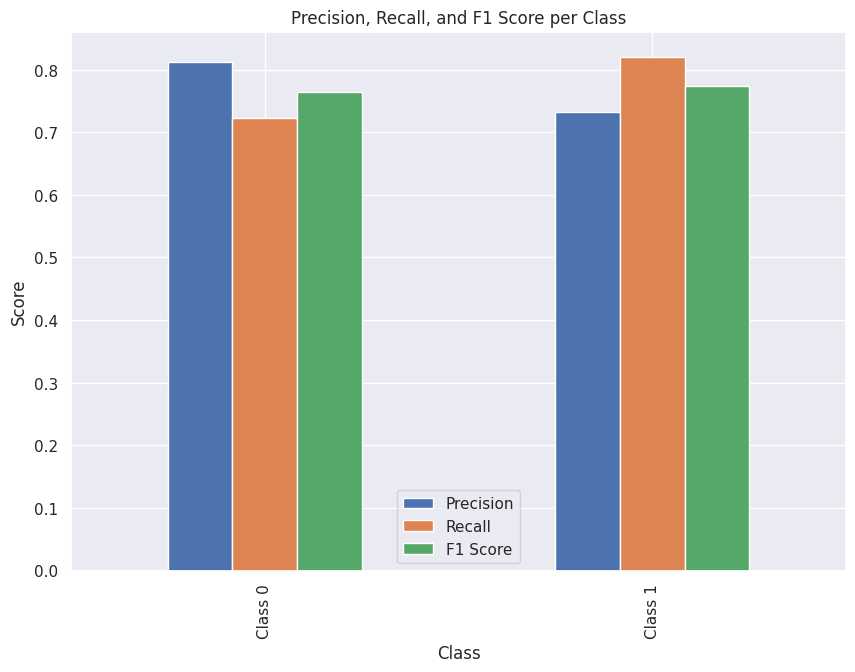

In [ ]:
import matplotlib.pyplot as plt

# Given metrics from your snippet
metrics = {
    'Class 0': {'Precision': 0.8125, 'Recall': 0.7222, 'F1 Score': 0.7647},
    'Class 1': {'Precision': 0.7321, 'Recall': 0.8200, 'F1 Score': 0.7736}
}

# Create a DataFrame from the metrics
import pandas as pd
df_metrics = pd.DataFrame(metrics).T

# Plotting
ax = df_metrics.plot(kind='bar', figsize=(10, 7))
ax.set_xlabel("Class")
ax.set_ylabel("Score")
ax.set_title("Precision, Recall, and F1 Score per Class")
plt.show()


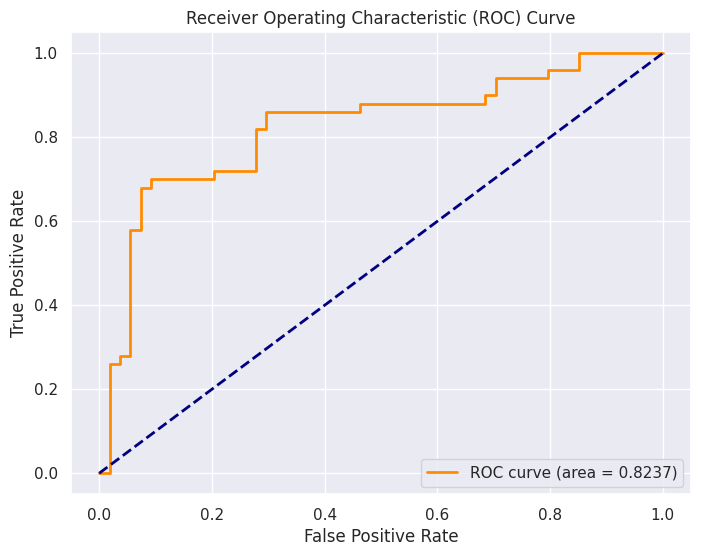

In [ ]:
from sklearn.metrics import roc_curve

# Calculate ROC curve
fpr, tpr, thresholds = roc_curve(y_test_labeled, y_pred)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {auc:.4f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


In [ ]:
from sklearn.metrics import classification_report

In [ ]:
report = classification_report(y_test_labeled, y_pred_binary, target_names=['Normal', 'Shoplifting'])
print(report)

              precision    recall  f1-score   support

      Normal       0.81      0.72      0.76        54
 Shoplifting       0.73      0.82      0.77        50

    accuracy                           0.77       104
   macro avg       0.77      0.77      0.77       104
weighted avg       0.77      0.77      0.77       104



In [ ]:
#SSAL
loss, accuracy = model.evaluate(X_test_labeled, y_test_labeled)
print("Test accuracy:", accuracy)

4/4 [==============================] - 0s 37ms/step - loss: 0.6555 - accuracy: 0.7692
Test accuracy: 0.7692307829856873


12. Prepare a New Video:

In [ ]:
def preprocess_video(video_paths):
    """Loads videos, extracts and preprocesses frames, and combines them into sequences.

    Args:
        video_paths (list): List of paths to video files.

    Returns:
        tuple: (video_sequences, labels)
            video_sequences (np.ndarray): 4D array of shape (num_videos, seq_length, height, width, channels)
    """

    video_sequences = []
    # for video_path in (video_paths):
        # Load video using OpenCV
    cap = cv2.VideoCapture(video_path)

    frames = []
    while True:
        ret, frame = cap.read()
        if not ret:
            break

        # Preprocess frame (e.g., resize, convert to grayscale)
        frame = cv2.resize(frame, (128, 128))  # Adjust frame size
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)  # Convert to grayscale

        frames.append(frame)

    cap.release()

    # Combine frames into sequences of specified length
    seq_length = 10  # Adjust sequence length
    video_sequences.append(np.array(frames[:seq_length]))

    # Normalize pixel values to [0, 1]
    video_sequences = np.array(video_sequences).astype('float32') / 255.0

    video_sequences = np.expand_dims(video_sequences, axis=-1)  # Add channel dimension

    return video_sequences


video_path = '/content/drive/MyDrive/FYP - Munz/Dataset/Test/shoplift_test_video.mp4'
test_video_sequences = preprocess_video(video_path)

In [ ]:
print(type(test_video_sequences))
print(test_video_sequences)

13. Make Predictions:

In [ ]:
#SSAL
predictions = model.predict(test_video_sequences)
print(predictions)

1/1 [==============================] - 0s 24ms/step
[[0.9921101]]


14. Visualize Predictions:

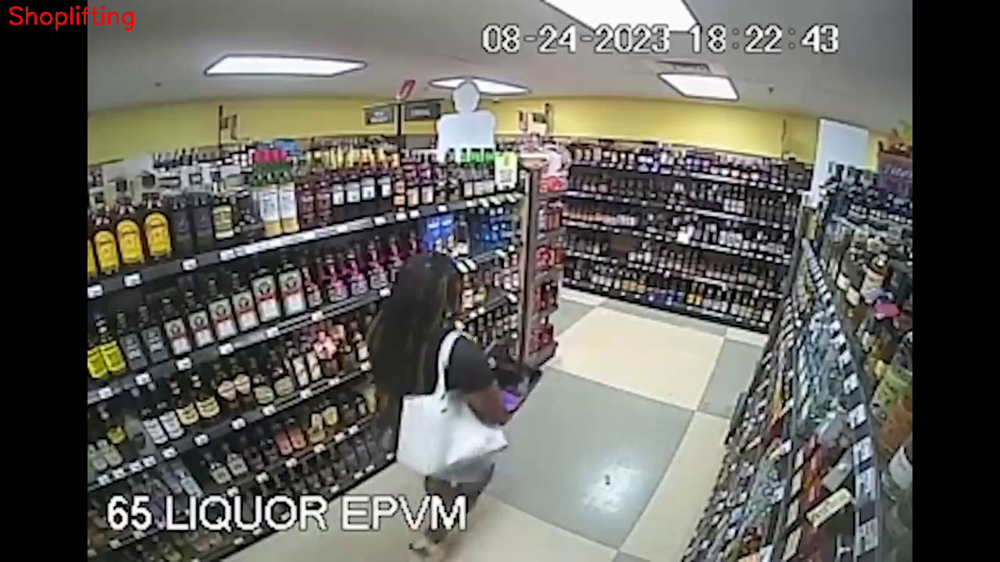

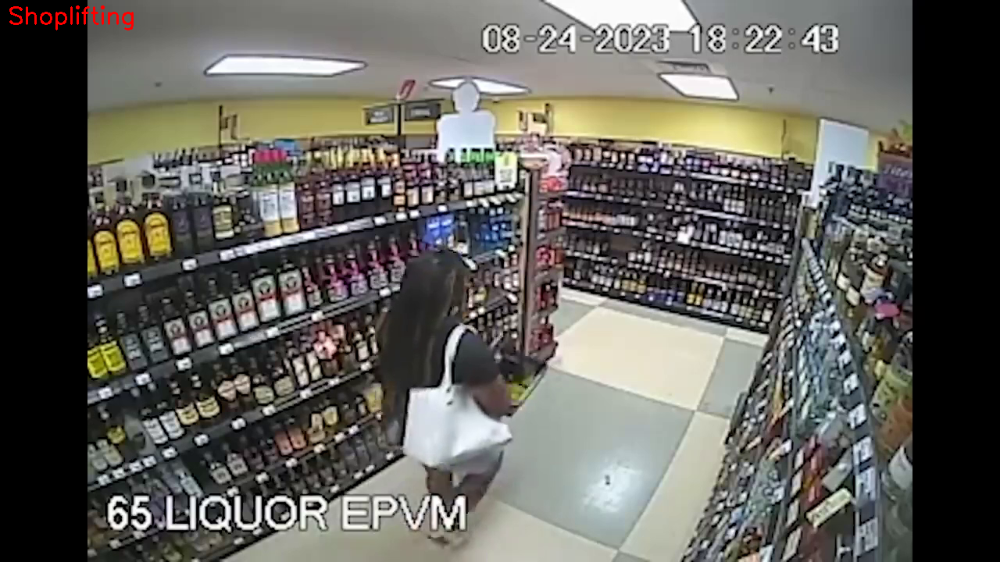

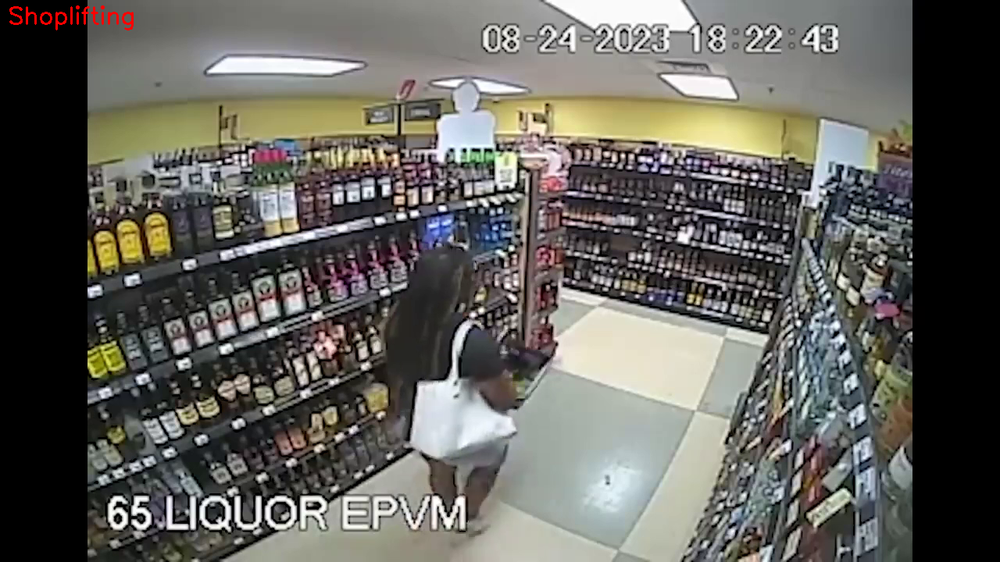

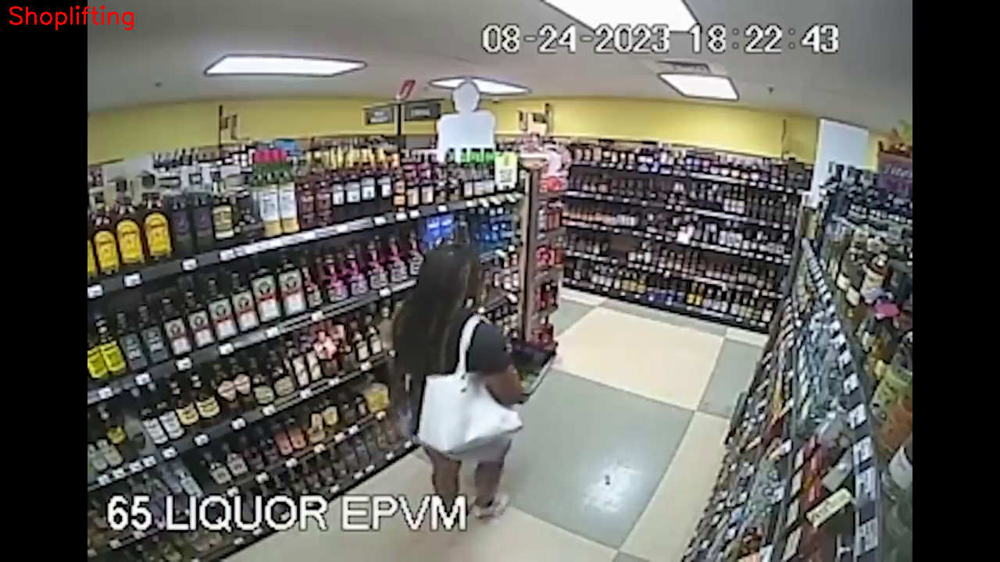

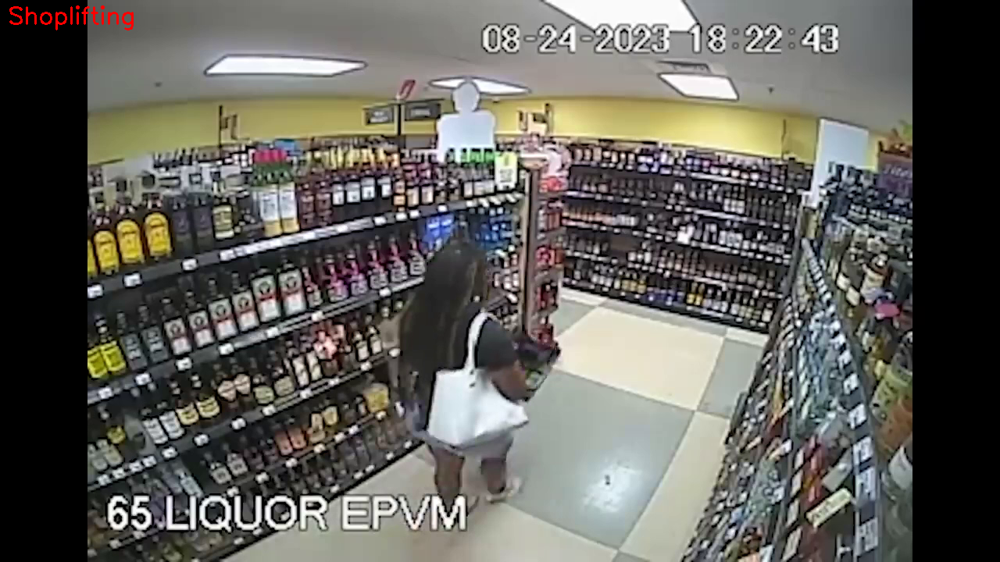

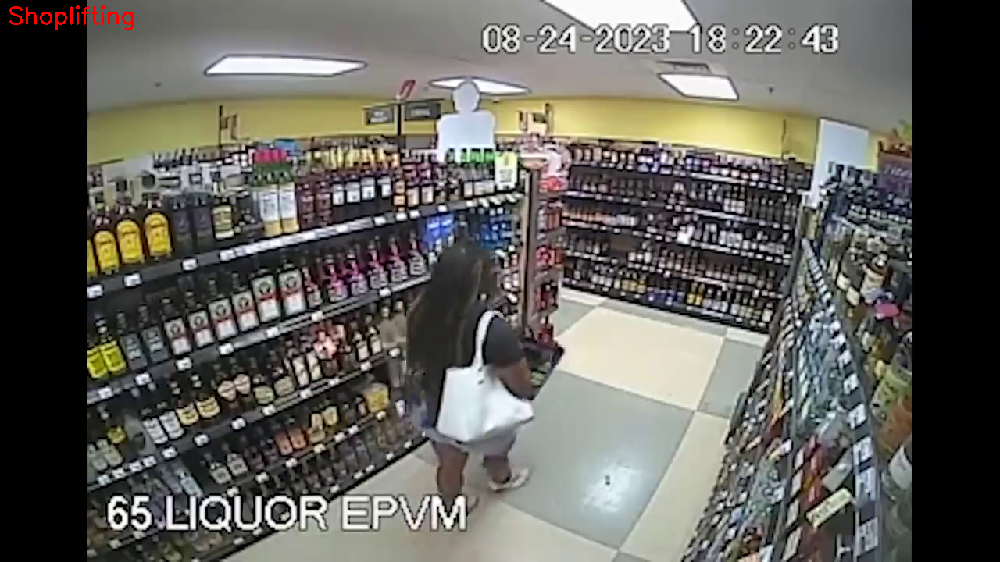

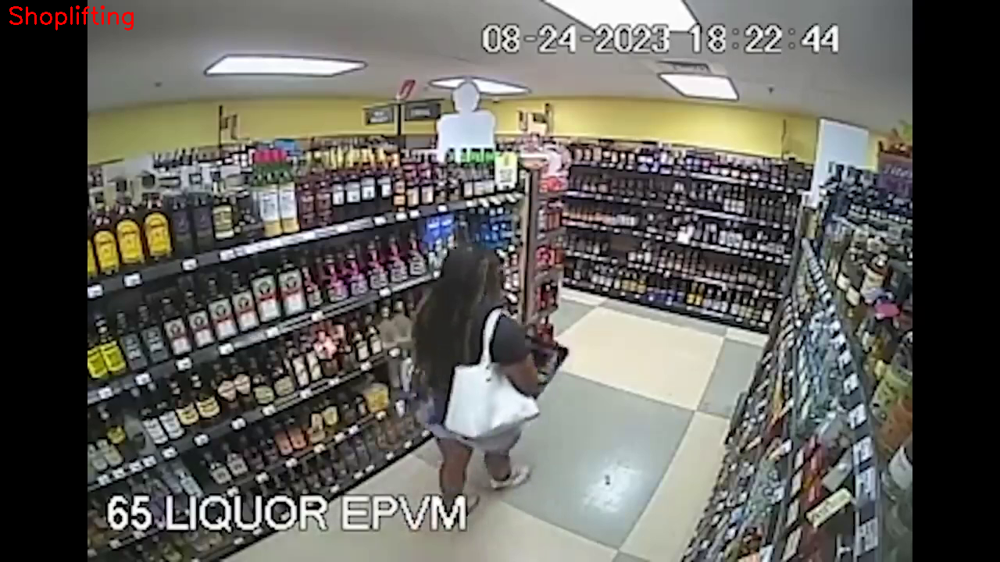

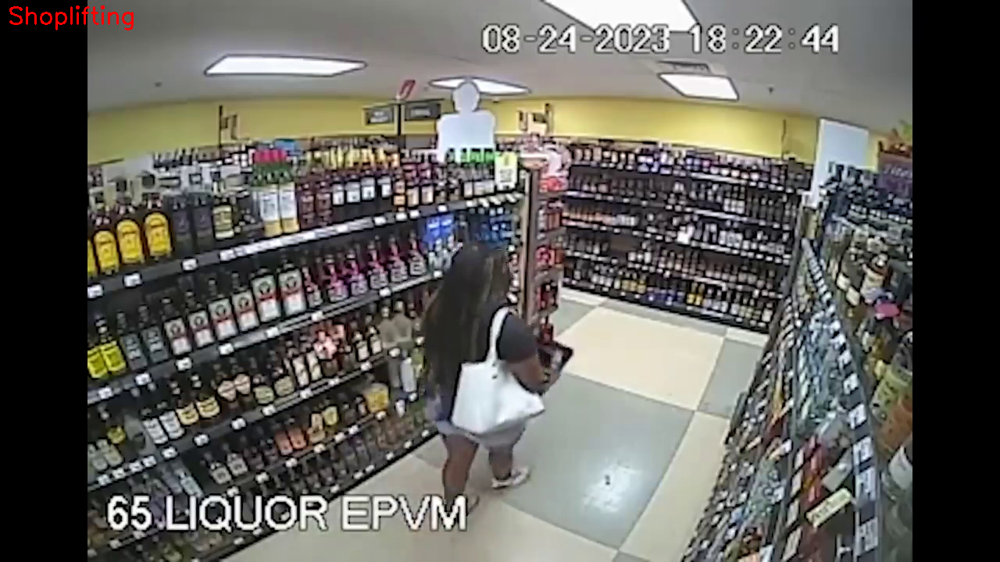

KeyboardInterrupt: 

In [ ]:
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

def visualize_predictions(video_path, predictions, threshold=0.5,desired_fps=10):
    cap = cv2.VideoCapture(video_path)
    frame_index = 0
    seq_length = 20

    # Calculate the delay between frames based on desired FPS
    delay = int(1000 / desired_fps)
    fps = cap.get(cv2.CAP_PROP_FPS)
    # print(fps)
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        # print(predictions)
        if len(predictions) == 1:  # Check for single prediction
            prediction = predictions[0][0]  # Access directly
        else:
            prediction = predictions[frame_index // seq_length][0]  # Access for multiple predictions

        if prediction > threshold:
            cv2.putText(frame, "Shoplifting", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)
        else:
            cv2.putText(frame, "Normal", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

        cv2_imshow(frame)
        if cv2.waitKey(delay) == ord('q'):
            break
        frame_index += 1

    cap.release()
    cv2.destroyAllWindows()

visualize_predictions(video_path, predictions, desired_fps=15)


In [ ]:
def preprocess_video(video_paths):
    """Loads videos, extracts and preprocesses frames, and combines them into sequences.

    Args:
        video_paths (list): List of paths to video files.

    Returns:
        tuple: (video_sequences, labels)
            video_sequences (np.ndarray): 4D array of shape (num_videos, seq_length, height, width, channels)
    """

    video_sequences = []
    cap = cv2.VideoCapture(video_path)

    frames = []
    while True:
        ret, frame = cap.read()
        if not ret:
            break

        # Preprocess frame (e.g., resize, convert to grayscale)
        frame = cv2.resize(frame, (128, 128))  # Adjust frame size
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)  # Convert to grayscale

        frames.append(frame)

    cap.release()

    # Combine frames into sequences of specified length
    seq_length = 10  # Adjust sequence length
    video_sequences.append(np.array(frames[:seq_length]))

    # Normalize pixel values to [0, 1]
    video_sequences = np.array(video_sequences).astype('float32') / 255.0

    video_sequences = np.expand_dims(video_sequences, axis=-1)  # Add channel dimension

    return video_sequences


video_path = '/content/drive/MyDrive/FYP - Munz/Dataset/Test/normal_test_video.mp4'
test_video_sequences = preprocess_video(video_path)

In [ ]:
#SSAL
predictions = model.predict(test_video_sequences)
print(predictions)

1/1 [==============================] - 0s 22ms/step
[[0.05050974]]


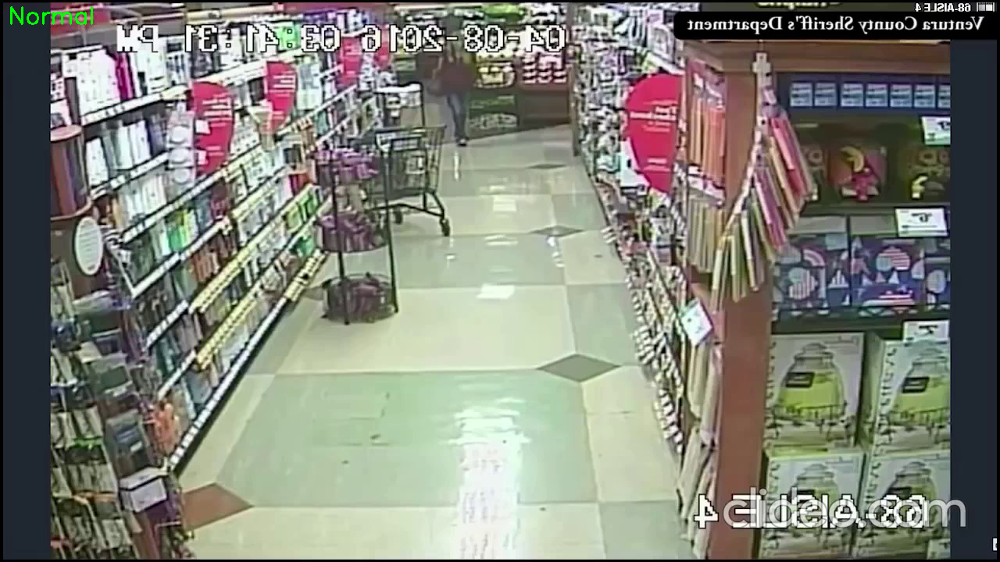

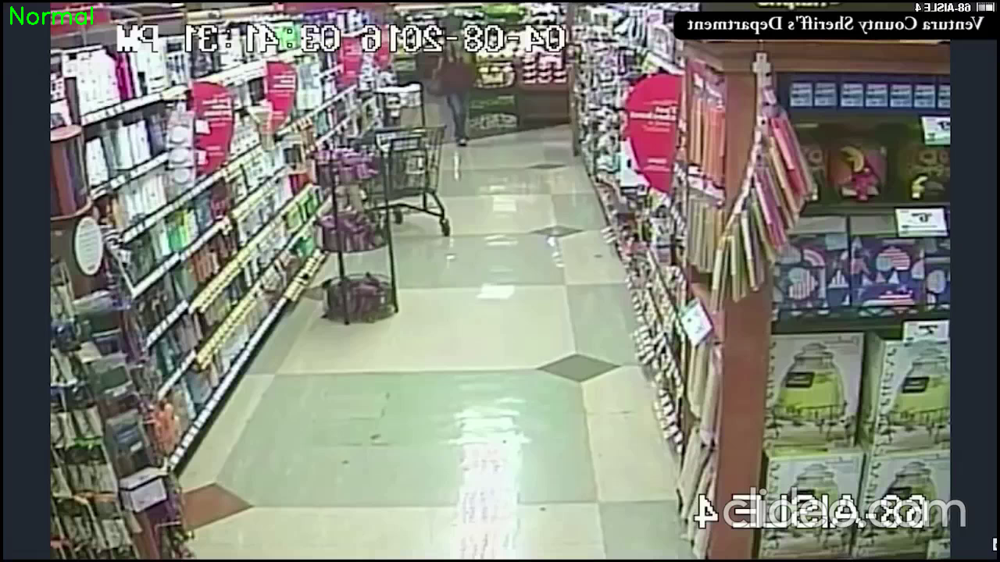

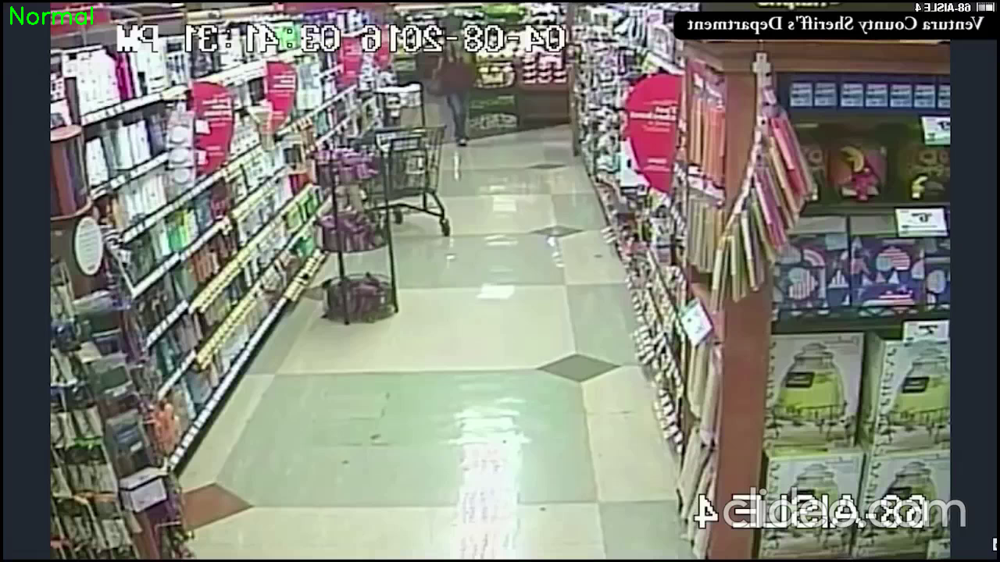

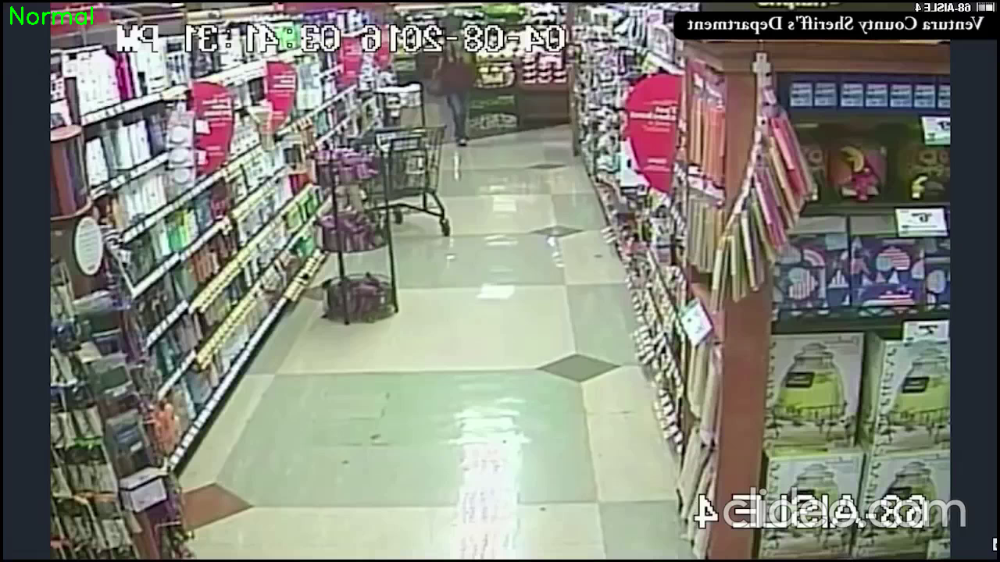

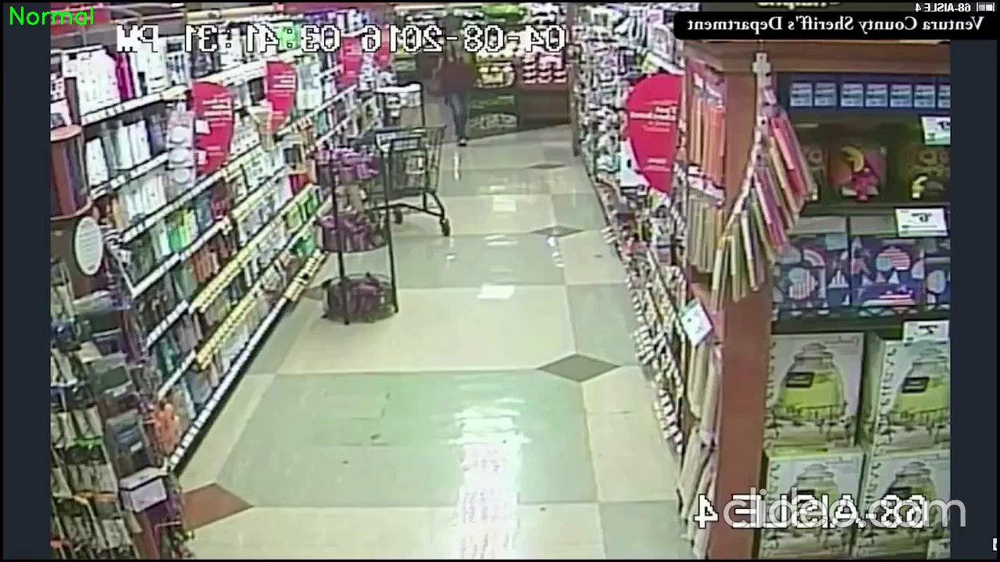

...

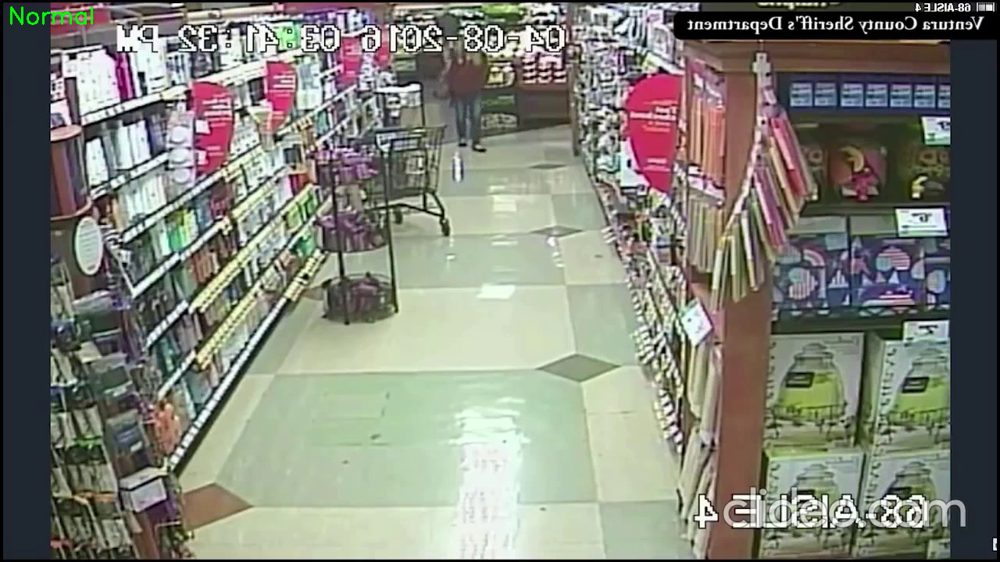

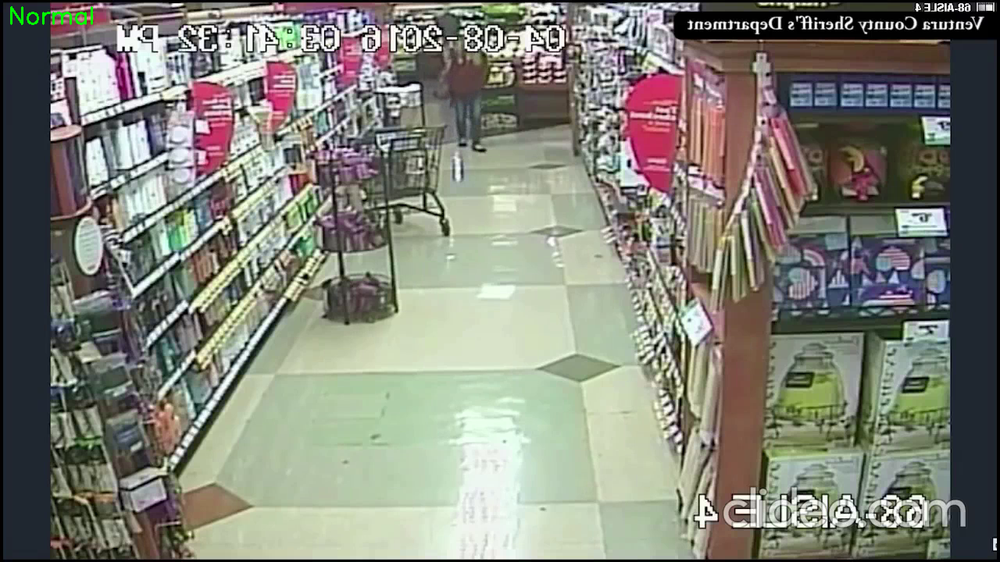

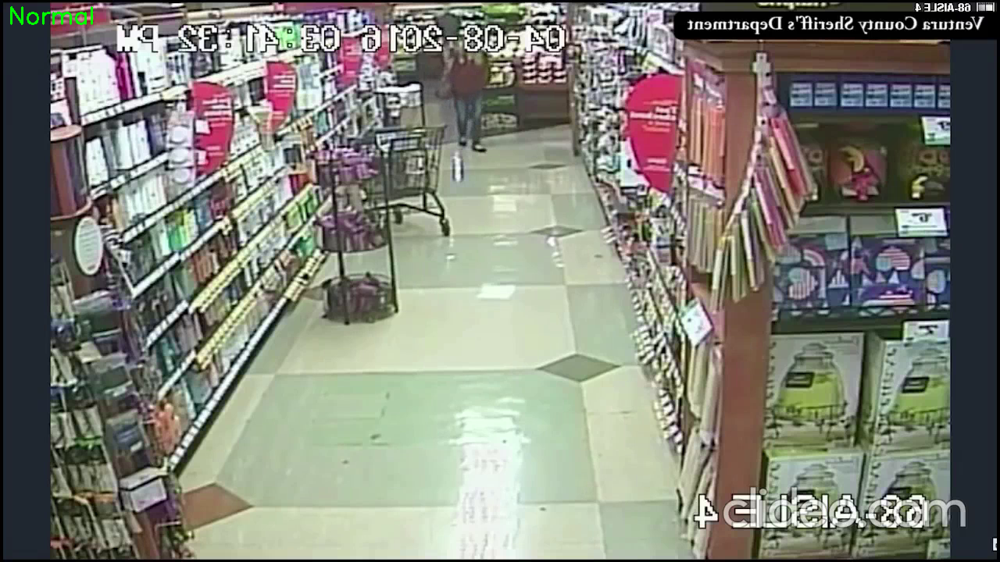

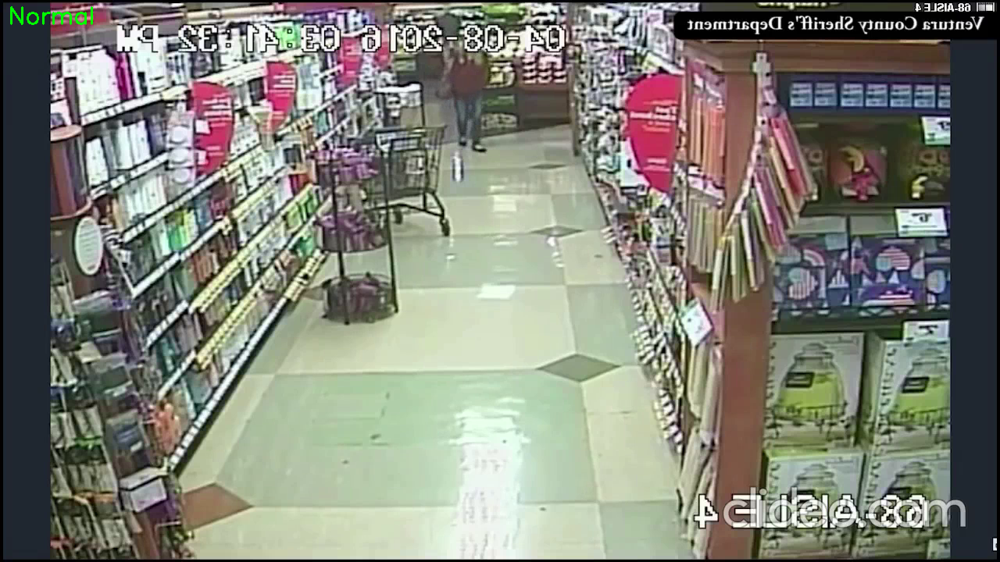

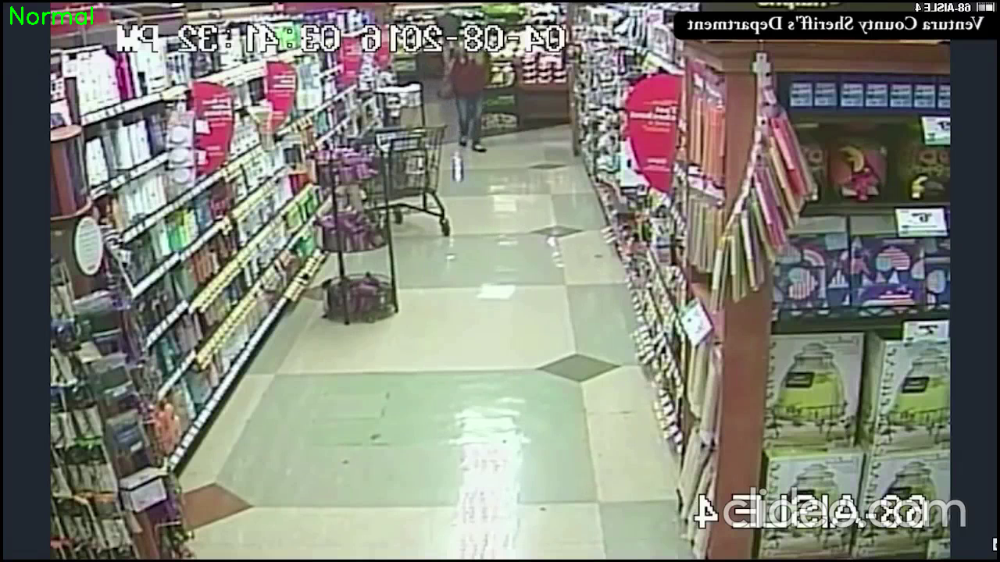

KeyboardInterrupt: 

In [ ]:
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

def visualize_predictions(video_path, predictions, threshold=0.5,desired_fps=10):
    cap = cv2.VideoCapture(video_path)
    frame_index = 0
    seq_length = 10
    delay = int(1000 / desired_fps)
    fps = cap.get(cv2.CAP_PROP_FPS)
    # print(fps)
    while True:
        ret, frame = cap.read()
        if not ret:
            break

        if len(predictions) == 1:  # Check for single prediction
            prediction = predictions[0][0]  # Access directly
        else:
            prediction = predictions[frame_index // seq_length][0]  # Access for multiple predictions

        if prediction > threshold:
            cv2.putText(frame, "Shoplifting", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)
        else:
            cv2.putText(frame, "Normal", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

        cv2_imshow(frame)
        if cv2.waitKey(1) == ord('q'):
            break
        frame_index += 1

    cap.release()
    cv2.destroyAllWindows()

visualize_predictions(video_path, predictions, desired_fps=15)
